## Object detection with TensorFlow 2 Object detection API

Dataset is obtained from [Kaggle](https://www.kaggle.com/datasets/lplenka/coco-car-damage-detection-dataset).

Click the image below to read the post online. 

<a target="_blank" href="https://www.machinelearningnuggets.com/object-detection-with-tensorflow-2-object-detection-api"><img src="https://www.machinelearningnuggets.com/content/images/2022/06/logo.png" alt="Open in ML Nuggets"></a>

### Download dataset and other essential files

In [1]:
!git clone https://github.com/mlnuggets/maskrcnn.git

Cloning into 'maskrcnn'...
remote: Enumerating objects: 130, done.
remote: Total 130 (delta 0), reused 0 (delta 0), pack-reused 130
Receiving objects: 100% (130/130), 31.96 MiB | 11.21 MiB/s, done.
Resolving deltas: 100% (24/24), done.


### Install TensorFlow 2 Object Detection API on Colab

In [2]:
!git clone https://github.com/tensorflow/models.git

Cloning into 'models'...
remote: Enumerating objects: 81530, done.
remote: Total 81530 (delta 0), reused 0 (delta 0), pack-reused 81530
Receiving objects: 100% (81530/81530), 596.11 MiB | 17.20 MiB/s, done.
Resolving deltas: 100% (58196/58196), done.


In [3]:
%%bash
cd models/research
# Compile protos.
protoc object_detection/protos/*.proto --python_out=.
# Install TensorFlow Object Detection API.
cp object_detection/packages/tf2/setup.py .
python -m pip install --use-feature=2020-resolver .

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Processing /content/models/research
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.6/14.6 MB 75.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 352.1/352.1 KB 41.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 91.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 26.9/26.9 MB 59.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 KB 9.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.6/116.6 KB 17.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 34.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 662.4/662.4 KB 50.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━

In [5]:
import matplotlib
import matplotlib.pyplot as plt
import os
import random
import io
import imageio
import glob
import scipy.misc
import numpy as np
from six import BytesIO
from PIL import Image, ImageDraw, ImageFont
from IPython.display import display, Javascript
from IPython.display import Image as IPyImage

import tensorflow as tf
from google.colab import files
import pathlib
import itertools
import random

from object_detection.utils import ops as utils_ops
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as viz_utils

from object_detection.utils import config_util
from object_detection.utils import colab_utils
from object_detection.builders import model_builder
%matplotlib inline

### Download Mask RCNN model

In [6]:
pip install wget 

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Preparing metadata (setup.py) ... done
  Created wheel for wget: filename=wget-3.2-py3-none-any.whl size=9674 sha256=f1e616bd8963b1596ce22c071614252ced0ae72bab1d9b4947f41ea039174eb6
  Stored in directory: /root/.cache/pip/wheels/bd/a8/c3/3cf2c14a1837a4e04bd98631724e81f33f462d86a1d895fae0
Successfully built wget


In [7]:
import wget

In [8]:
model_link = "http://download.tensorflow.org/models/object_detection/tf2/20200711/mask_rcnn_inception_resnet_v2_1024x1024_coco17_gpu-8.tar.gz"
wget.download(model_link)

'mask_rcnn_inception_resnet_v2_1024x1024_coco17_gpu-8.tar.gz'

In [10]:
import tarfile
tar = tarfile.open('/content/mask_rcnn_inception_resnet_v2_1024x1024_coco17_gpu-8.tar.gz')
tar.extractall('.') 
tar.close()

### install right OpenCV version

In [11]:
pip uninstall opencv-python-headless==4.5.5.62

Found existing installation: opencv-python-headless 4.7.0.68
Uninstalling opencv-python-headless-4.7.0.68:
  Would remove:
    /usr/local/lib/python3.8/dist-packages/cv2/*
    /usr/local/lib/python3.8/dist-packages/opencv_python_headless-4.7.0.68.dist-info/*
    /usr/local/lib/python3.8/dist-packages/opencv_python_headless.libs/libavcodec-087c3416.so.59.37.100
    /usr/local/lib/python3.8/dist-packages/opencv_python_headless.libs/libavformat-85e01647.so.59.27.100
    /usr/local/lib/python3.8/dist-packages/opencv_python_headless.libs/libavutil-82c407cb.so.57.28.100
    /usr/local/lib/python3.8/dist-packages/opencv_python_headless.libs/libcrypto-9cee340d.so.1.1
    /usr/local/lib/python3.8/dist-packages/opencv_python_headless.libs/libgfortran-91cc3cb1.so.3.0.0
    /usr/local/lib/python3.8/dist-packages/opencv_python_headless.libs/libopenblas-r0-f650aae0.3.3.so
    /usr/local/lib/python3.8/dist-packages/opencv_python_headless.libs/libpng16-186fce2e.so.16.37.0
    /usr/local/lib/python3.8/

In [13]:
pip install opencv-python-headless==4.5.2.52

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 38.2/38.2 MB 33.0 MB/s eta 0:00:00


### Install right version of libcudnn8

In [14]:
!apt install --allow-change-held-packages libcudnn8=8.1.0.77-1+cuda11.2

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following package was automatically installed and is no longer required:
  libnvidia-common-510
Use 'apt autoremove' to remove it.
The following packages will be REMOVED:
  libcudnn8-dev
The following held packages will be changed:
  libcudnn8
The following packages will be DOWNGRADED:
  libcudnn8
0 upgraded, 0 newly installed, 1 downgraded, 1 to remove and 19 not upgraded.
Need to get 430 MB of archives.
After this operation, 1,383 MB disk space will be freed.
Get:1 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2004/x86_64  libcudnn8 8.1.0.77-1+cuda11.2 [430 MB]
Fetched 430 MB in 5s (84.2 MB/s)
(Reading database ... 128126 files and directories currently installed.)
Removing libcudnn8-dev (8.4.0.27-1+cuda11.6) ...
update-alternatives: removing manually selected alternative - switching libcudnn to auto mode
dpkg: warning: downgrading libcudnn8 from 8.4.0.27-1+cuda11.6 to

### Convert the data to TFRecords

In [15]:
!python /content/maskrcnn/create_coco_tf_record.py --logtostderr \
      --train_image_dir=/content/maskrcnn/data/train  \
      --test_image_dir=/content/maskrcnn/data/val \
      --train_annotations_file=/content/maskrcnn/data/train/COCO_mul_train_annos.json \
      --test_annotations_file=/content/maskrcnn/data/val/COCO_mul_val_annos.json \
      --output_dir=/content/maskrcnn/data/tf_records

2023-02-21 07:36:36.804043: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-02-21 07:36:36.804189: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-02-21 07:36:36.804214: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Cannot dlopen some TensorRT libraries. If you would like to use Nvidia GPU with TensorRT, please make sure the missing libraries mentioned above are installed properly.
INFO:tensorflow:Found groundtruth annotations. Building annotations index.
I0221 07:36:40.040327 139710468966208 create_coco_tf_record.py:221] Found groundtruth annota

## Train the model

In [16]:
!python /content/models/research/object_detection/model_main_tf2.py\
    --pipeline_config_path=/content/maskrcnn/mask_rcnn_inception_resnet_v2_1024x1024_coco17_gpu-8-colab.config \
    --model_dir=/content/training \
    --alsologtostderr

2023-02-21 07:36:53.295893: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-02-21 07:36:53.296019: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-02-21 07:36:53.296043: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Cannot dlopen some TensorRT libraries. If you would like to use Nvidia GPU with TensorRT, please make sure the missing libraries mentioned above are installed properly.
2023-02-21 07:36:59.423581: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:42] Overriding orig_value setting because the TF_FORCE_GPU_ALLOW_GROWTH environme

## Model evaluation and visualization

In [17]:
%load_ext tensorboard
%tensorboard --logdir '/content/training/train'

<IPython.core.display.Javascript object>

## Export trained inference graph

In [18]:
pipeline_file = '/content/maskrcnn/mask_rcnn_inception_resnet_v2_1024x1024_coco17_gpu-8-colab.config'
last_model_path = '/content/training/'
output_directory = "/content/finetuned-maskrcnn"

In [19]:
%ls '/content/training/'

checkpoint                  ckpt-1.index                ckpt-2.index
ckpt-1.data-00000-of-00001  ckpt-2.data-00000-of-00001  train/


### Run conversion script

In [20]:
!python /content/models/research/object_detection/exporter_main_v2.py \
    --trained_checkpoint_dir {last_model_path} \
    --output_directory {output_directory} \
    --pipeline_config_path {pipeline_file}

2023-02-21 07:55:48.023705: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-02-21 07:55:48.023806: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-02-21 07:55:48.023826: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Cannot dlopen some TensorRT libraries. If you would like to use Nvidia GPU with TensorRT, please make sure the missing libraries mentioned above are installed properly.
2023-02-21 07:55:52.163951: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:42] Overriding orig_value setting because the TF_FORCE_GPU_ALLOW_GROWTH environme

### Download model from Colab

In [ ]:
# !zip -r /content/maskrcnn.zip /content/training
# files.download("/content/maskrcnn.zip")

In [ ]:
# !zip -r /content/fine_tuned_model.zip /content/finetuned-maskrcnn
# files.download("/content/fine_tuned_model.zip")

In [21]:
%ls '/content/finetuned-maskrcnn/saved_model/'

assets/  fingerprint.pb  saved_model.pb  variables/


### Load an image from file into a numpy array

In [23]:
def load_image_into_numpy_array(path):
  """Load an image from file into a numpy array.

  Puts image into numpy array to feed into tensorflow graph.
  Note that by convention we put it into a numpy array with shape
  (height, width, channels), where channels=3 for RGB.

  Args:
    path: a file path.

  Returns:
    uint8 numpy array with shape (img_height, img_width, 3)
  """
  img_data = tf.io.gfile.GFile(path, 'rb').read()
  image = Image.open(BytesIO(img_data))
  (im_width, im_height) = image.size
  return np.array(image.getdata()).reshape(
      (im_height, im_width, 3)).astype(np.uint8)


### Visualize detections

In [24]:
def plot_detections(image_np,
                    boxes,
                    classes,
                    scores,
                    category_index,
                    figsize=(12, 16),
                    image_name=None):
  """Wrapper function to visualize detections.

  Args:
    image_np: uint8 numpy array with shape (img_height, img_width, 3)
    boxes: a numpy array of shape [N, 4]
    classes: a numpy array of shape [N]. Note that class indices are 1-based,
      and match the keys in the label map.
    scores: a numpy array of shape [N] or None.  If scores=None, then
      this function assumes that the boxes to be plotted are groundtruth
      boxes and plot all boxes as black with no classes or scores.
    category_index: a dict containing category dictionaries (each holding
      category index `id` and category name `name`) keyed by category indices.
    figsize: size for the figure.
    image_name: a name for the image file.
  """
  image_np_with_annotations = image_np.copy()
  viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_annotations,
      boxes,
      classes,
      scores,
      category_index,
      use_normalized_coordinates=True,
      min_score_thresh=0.8)
  if image_name:
    plt.imsave(image_name, image_np_with_annotations)
  else:
    plt.imshow(image_np_with_annotations)

## Create model from the last checkpoint

In [25]:
filenames = list(pathlib.Path('/content/training/').glob('*.index'))

filenames.sort()
print(filenames)

#recover our saved model
model_dir = '/content/training/'
#generally you want to put the last ckpt from training in here
configs = config_util.get_configs_from_pipeline_file(pipeline_file)
model_config = configs['model']
detection_model = model_builder.build(
      model_config=model_config, is_training=False)

# Restore checkpoint
ckpt = tf.compat.v2.train.Checkpoint(
      model=detection_model)
ckpt.restore(os.path.join(str(filenames[-1]).replace('.index','')))


def get_model_detection_function(model):
  """Get a tf.function for detection."""

  @tf.function
  def detect_fn(image):
    """Detect objects in image."""

    image, shapes = model.preprocess(image)
    prediction_dict = model.predict(image, shapes)
    detections = model.postprocess(prediction_dict, shapes)

    return detections, prediction_dict, tf.reshape(shapes, [-1])

  return detect_fn

detect_fn = get_model_detection_function(detection_model)

[PosixPath('/content/training/ckpt-1.index'), PosixPath('/content/training/ckpt-2.index')]


## Map labels for inference decoding

In [26]:
#map labels for inference decoding
label_map_path = configs['eval_input_config'].label_map_path
label_map = label_map_util.load_labelmap(label_map_path)
categories = label_map_util.convert_label_map_to_categories(
    label_map,
    max_num_classes=label_map_util.get_max_label_map_index(label_map),
    use_display_name=True)
category_index = label_map_util.create_category_index(categories)
label_map_dict = label_map_util.get_label_map_dict(label_map, use_display_name=True)

### Run detector on test image

Instructions for updating:
Lambda fuctions will be no more assumed to be used in the statement where they are used, or at least in the same block. https://github.com/tensorflow/tensorflow/issues/56089
Instructions for updating:
box_ind is deprecated, use box_indices instead
Instructions for updating:
Use ref() instead.
Instructions for updating:
`tf.batch_gather` is deprecated, please use `tf.gather` with `batch_dims=tf.rank(indices) - 1` instead.


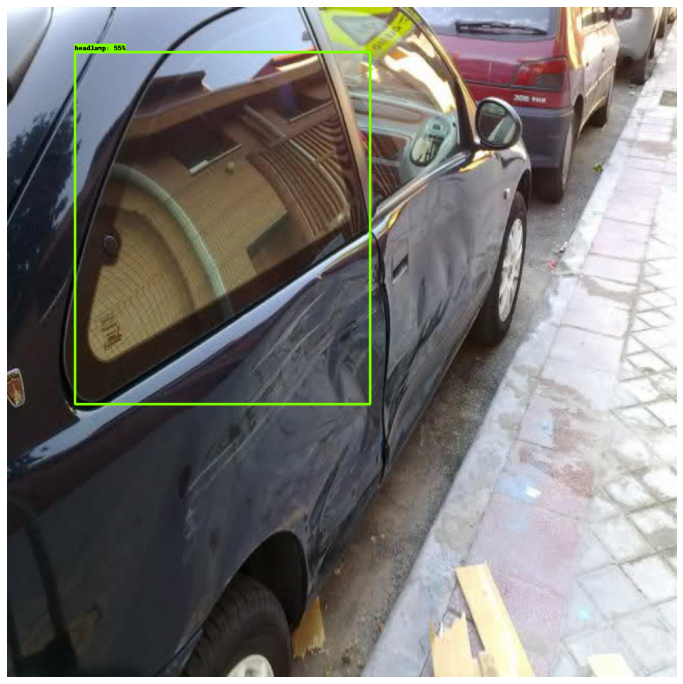

In [27]:
#run detector on test image
#it takes a little longer on the first run and then runs at normal speed. 
TEST_IMAGE_PATHS = glob.glob('/content/maskrcnn/data/test/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

# Things to try:
# Flip horizontally
# image_np = np.fliplr(image_np).copy()

# Convert image to grayscale
# image_np = np.tile(
#     np.mean(image_np, 2, keepdims=True), (1, 1, 3)).astype(np.uint8)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)
plt.axis("off")
plt.show()

## Use model for image segmentation

In [28]:
# patch tf1 into `utils.ops`
utils_ops.tf = tf.compat.v1
# Patch the location of gfile
tf.gfile = tf.io.gfile

In [29]:
def load_model(model_dir):
    
    model = tf.saved_model.load(str(model_dir))
    return model

In [30]:
model_dir = '/content/finetuned-maskrcnn/saved_model'
masking_model = load_model(model_dir)

### Set label map

In [31]:
# List of the strings that is used to add correct label for each box.
PATH_TO_LABELS = '/content/maskrcnn/data/labelmap.pbtxt'
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS, use_display_name=True)

### Set test image paths

In [32]:
# If you want to test the code with your images, just add path to the images to the TEST_IMAGE_PATHS.
PATH_TO_TEST_IMAGES_DIR = pathlib.Path('/content/maskrcnn/data/test')
TEST_IMAGE_PATHS = sorted(list(PATH_TO_TEST_IMAGES_DIR.glob("*.jpg")))
TEST_IMAGE_PATHS

[PosixPath('/content/maskrcnn/data/test/11.jpg'),
 PosixPath('/content/maskrcnn/data/test/12.jpg'),
 PosixPath('/content/maskrcnn/data/test/28.jpg'),
 PosixPath('/content/maskrcnn/data/test/45.jpg'),
 PosixPath('/content/maskrcnn/data/test/60.jpg'),
 PosixPath('/content/maskrcnn/data/test/66.jpg'),
 PosixPath('/content/maskrcnn/data/test/67.jpg'),
 PosixPath('/content/maskrcnn/data/test/72.jpg')]

### Create inference function

In [33]:
def run_inference_for_single_image(model, image_np):
    
    print("Running inference for : ",image_path)

    # The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
    input_tensor = tf.convert_to_tensor(image_np)
    
    # The model expects a batch of images, so add an axis with `tf.newaxis`.
    input_tensor = input_tensor[tf.newaxis, ...]

    detections = model(input_tensor)

    # All outputs are batches tensors.
    # Convert to numpy arrays, and take index [0] to remove the batch dimension.
    # We're only interested in the first num_detections.
    num_detections = int(detections.pop("num_detections"))

    detections = dict(itertools.islice(detections.items(), num_detections))

    detections["num_detections"] = num_detections

    image_np_with_detections = image_np.copy()

    # Handle models with masks:
    if "detection_masks" in detections:
        # Reframe the the bbox mask to the image size.
        detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
              detections["detection_masks"][0], detections["detection_boxes"][0],
               image_np.shape[0], image_np.shape[1])      
        detection_masks_reframed = tf.cast(detection_masks_reframed > 0.5,
                                       tf.uint8)
        detections["detection_masks_reframed"] = detection_masks_reframed.numpy()

    boxes = np.asarray(detections["detection_boxes"][0])
    classes = np.asarray(detections["detection_classes"][0]).astype(np.int64)
    scores = np.asarray(detections["detection_scores"][0])
    mask = np.asarray(detections["detection_masks_reframed"])

    # Visualizing the results
    viz_utils.visualize_boxes_and_labels_on_image_array(
        image_np_with_detections,
        boxes,
        classes,
        scores,
        category_index,
        instance_masks=mask,
        use_normalized_coordinates=True,
        line_thickness=3)
    
    # Display image with detections and segmented parts
    display(Image.fromarray(image_np_with_detections))

In [34]:
def show_inference(model, image_path):

    # Load image
    image_np = np.array(Image.open(image_path))
    
    # Actual detection.
    output_dict = run_inference_for_single_image(model, image_np)


## Perform segmentation and detection

Running inference for :  /content/maskrcnn/data/test/11.jpg


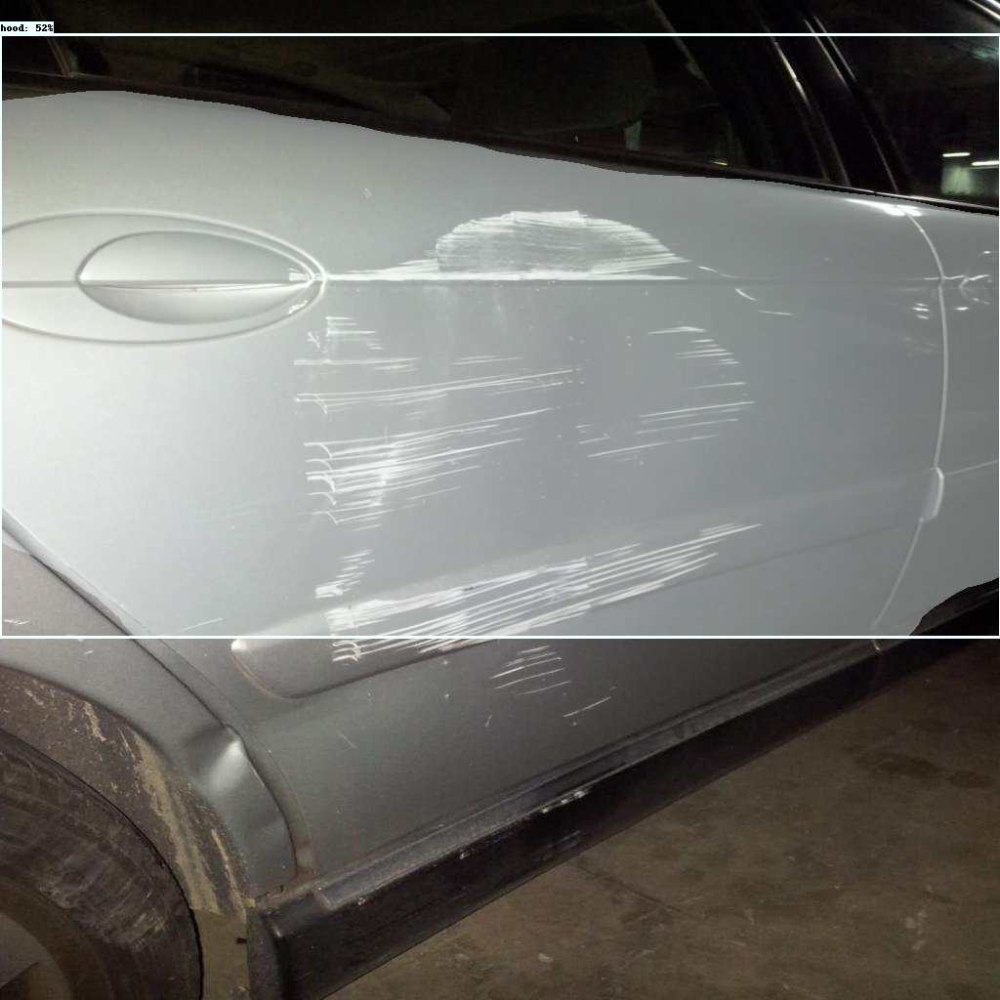

Running inference for :  /content/maskrcnn/data/test/12.jpg


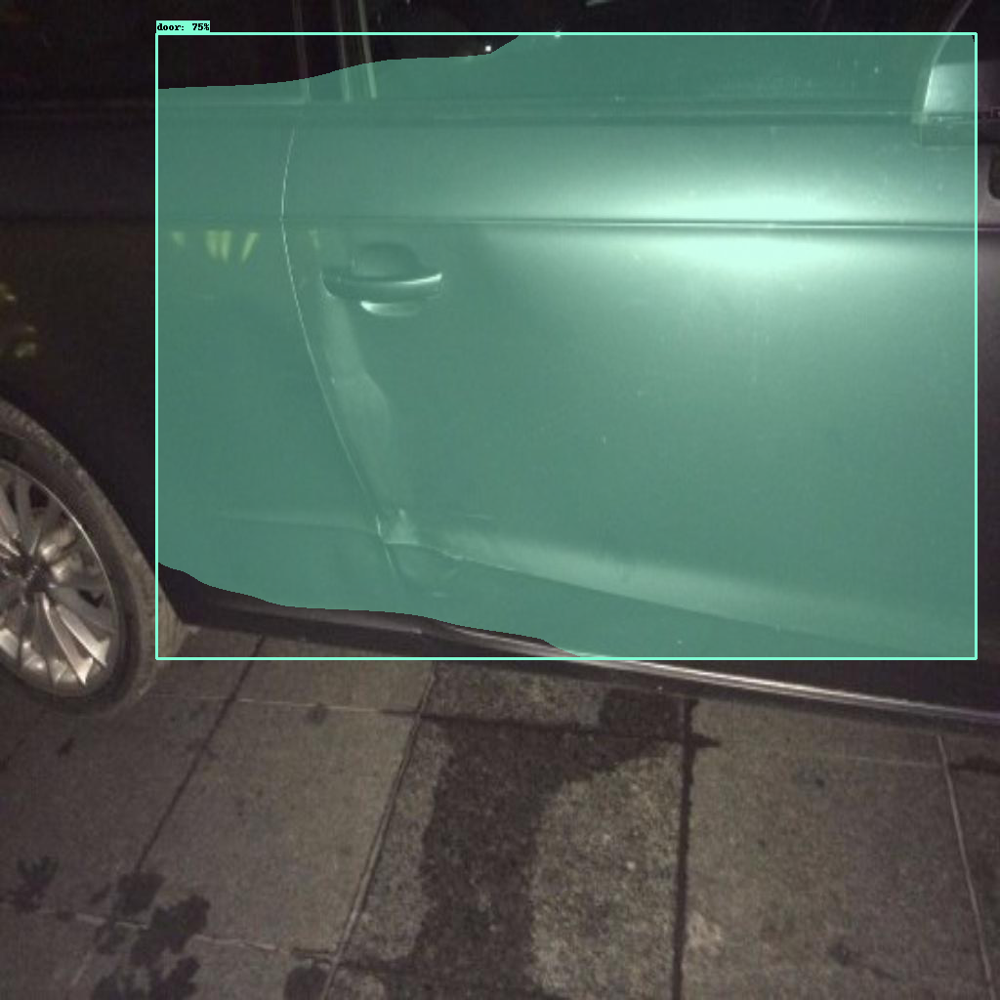

Running inference for :  /content/maskrcnn/data/test/28.jpg


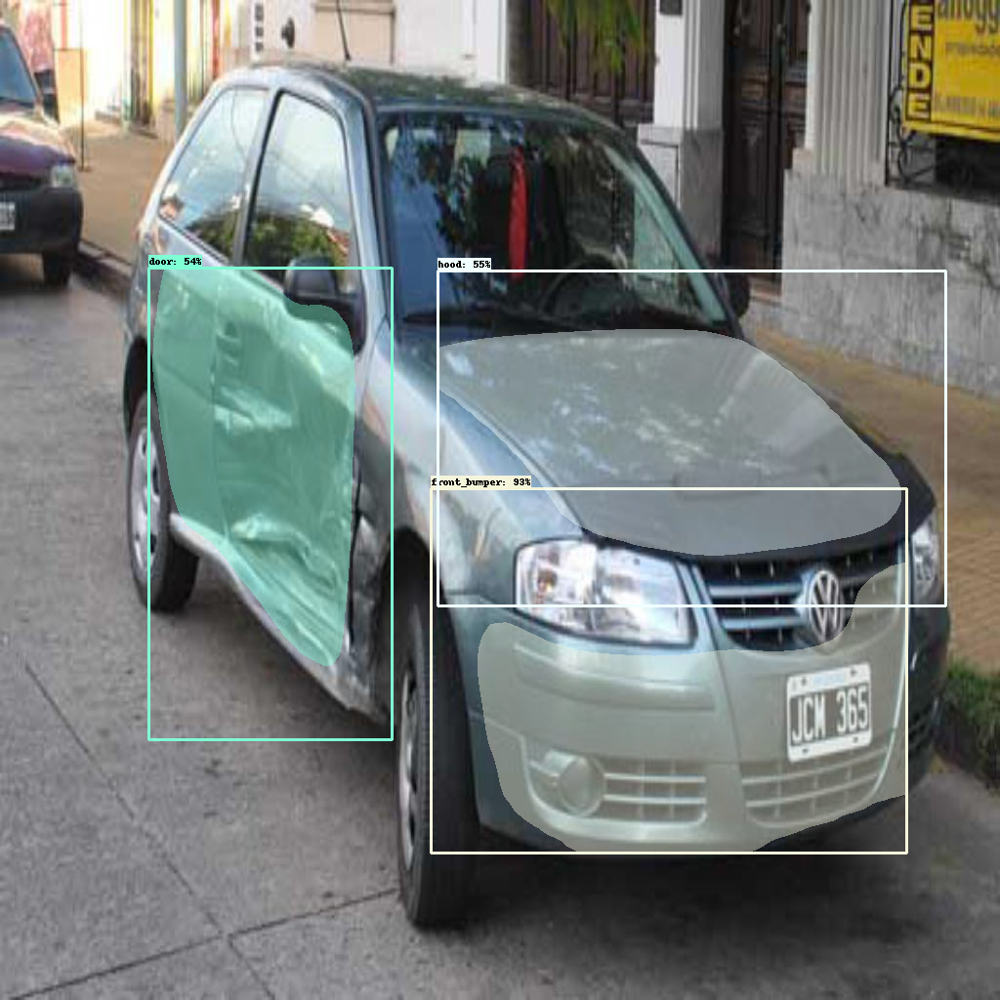

Running inference for :  /content/maskrcnn/data/test/45.jpg


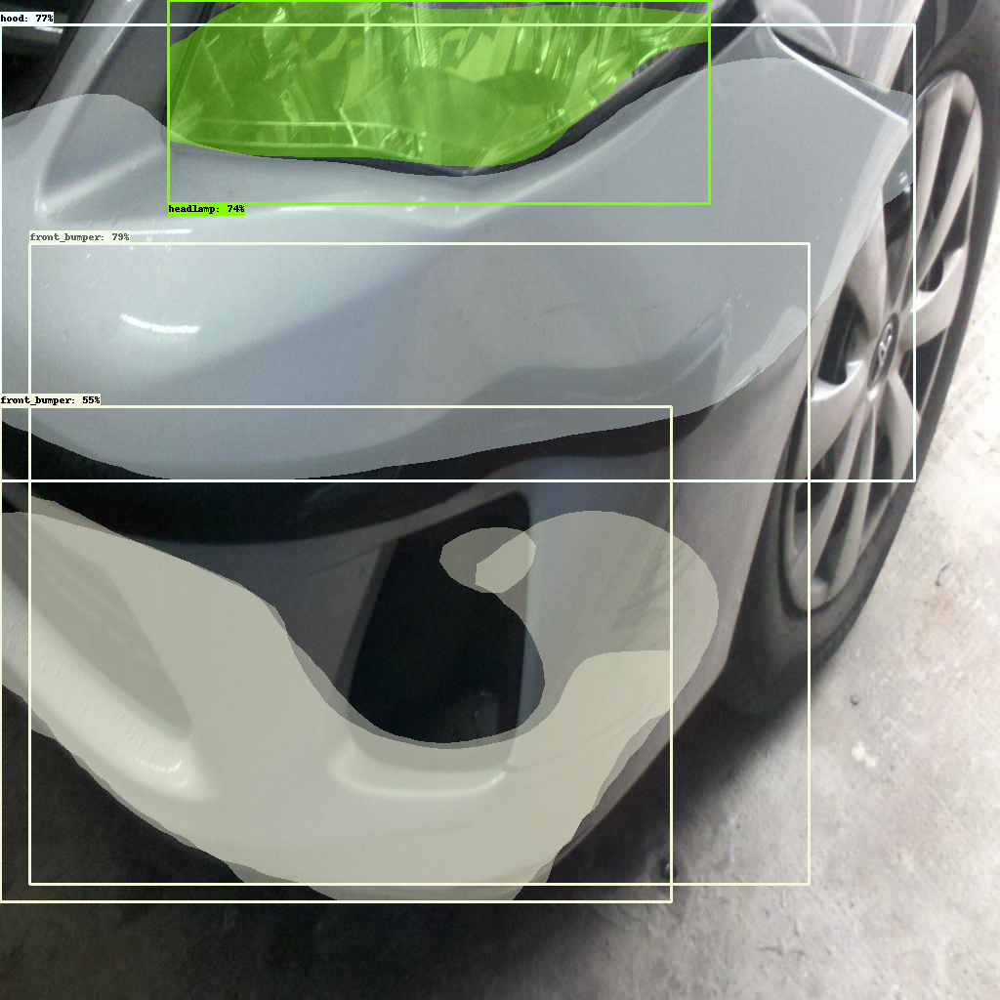

Running inference for :  /content/maskrcnn/data/test/60.jpg


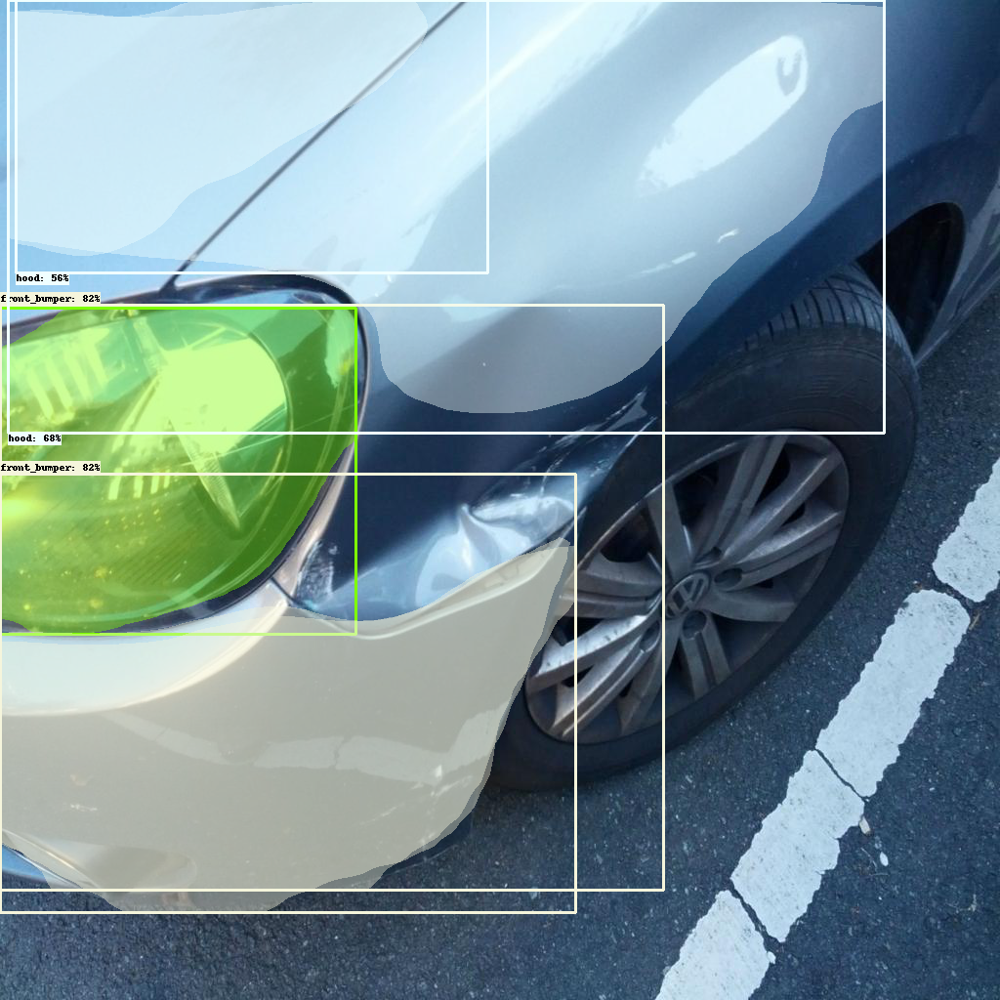

Running inference for :  /content/maskrcnn/data/test/66.jpg


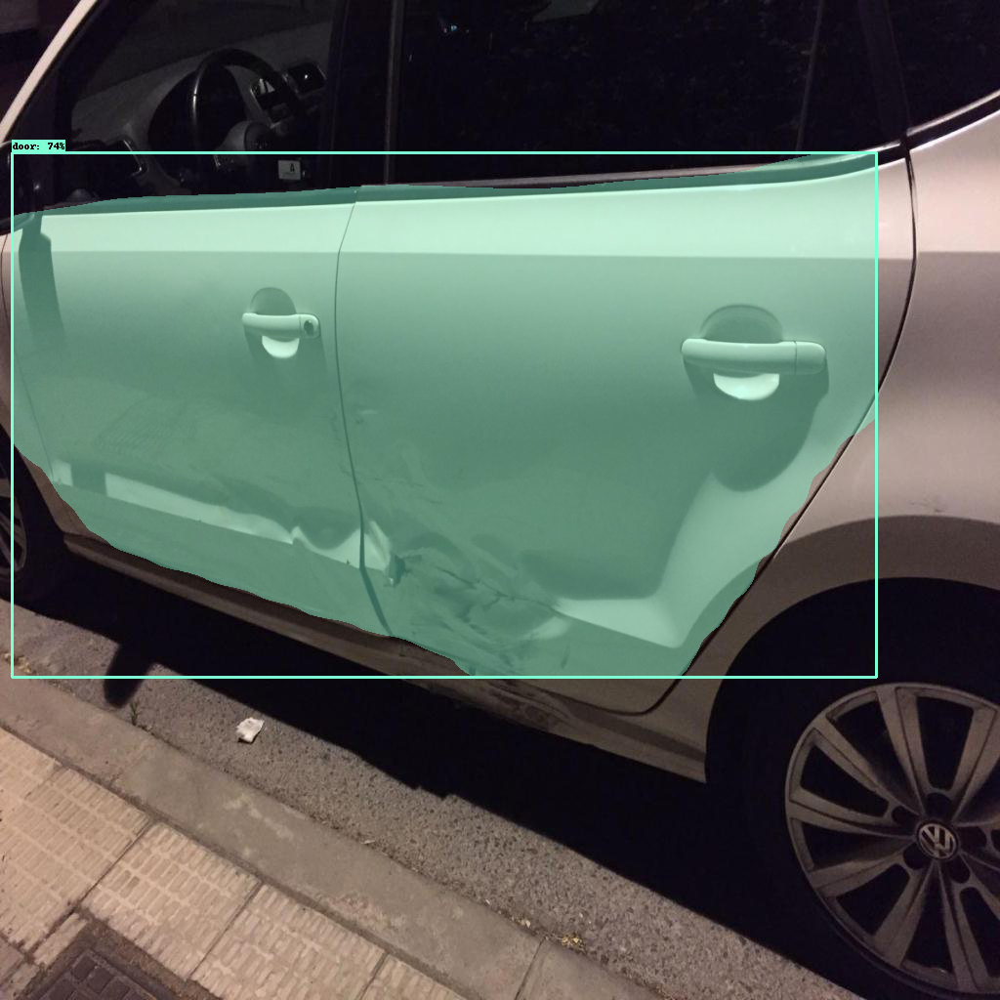

Running inference for :  /content/maskrcnn/data/test/67.jpg


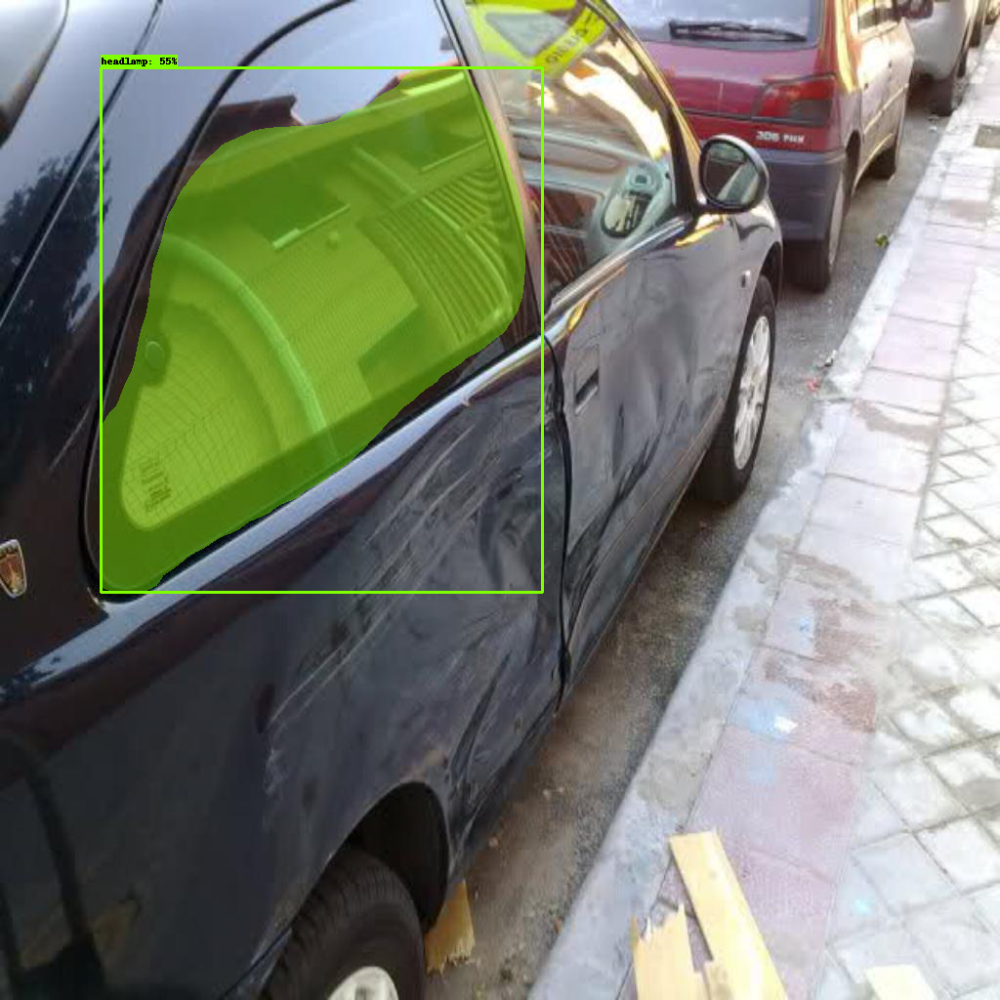

Running inference for :  /content/maskrcnn/data/test/72.jpg


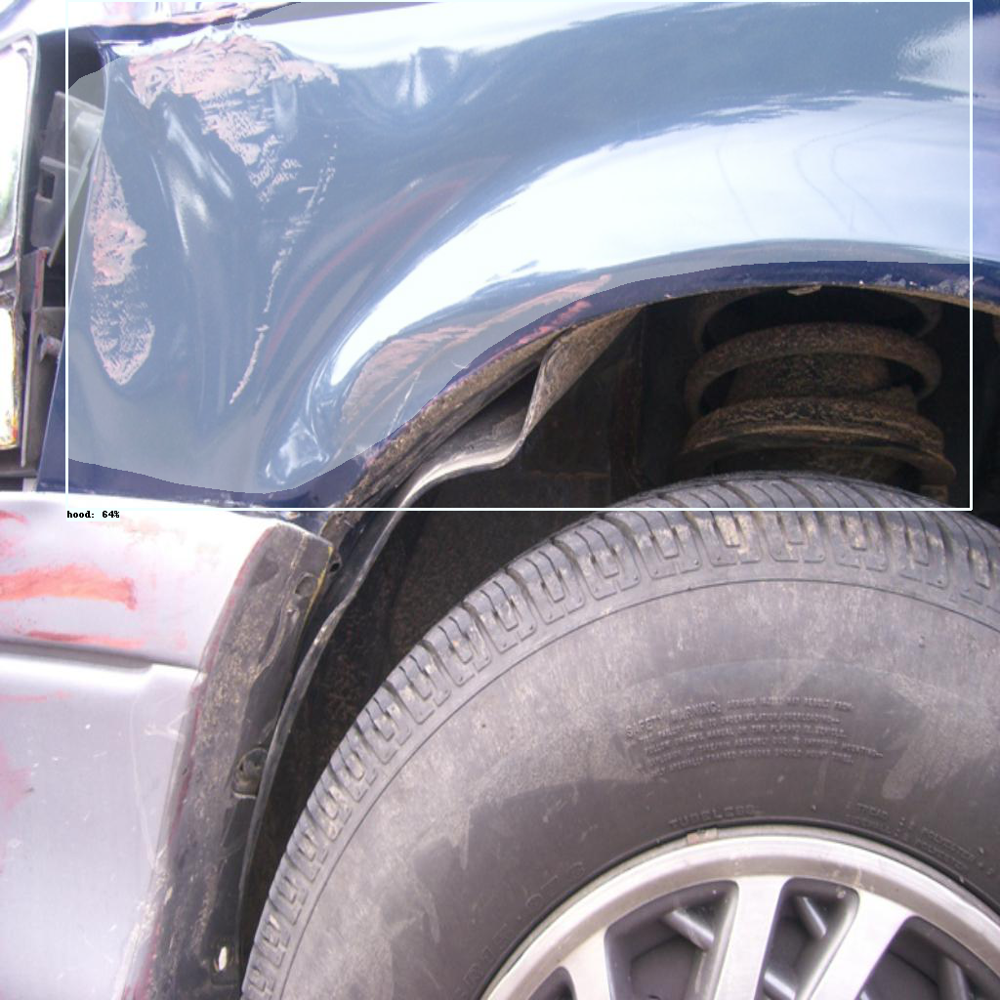

In [35]:
for image_path in TEST_IMAGE_PATHS:
    show_inference(masking_model, image_path)

## Where to go from here
Follow us on [LinkedIn](https://www.linkedin.com/company/mlnuggets), [Twitter](https://twitter.com/ml_nuggets), [GitHub](https://github.com/mlnuggets) and subscribe to our [blog](https://www.machinelearningnuggets.com/#/portal) so that you don't miss a new issue.